In [1]:
import torch
from torch import nn
from matplotlib import pyplot as plt
import numpy as np

import shutil
import tempfile

import sys

sys.path.append("..")
from datasets import load_data, MNIST

In [2]:

# Start tensorboard

shutil.rmtree(tempfile.gettempdir() + "/.tensorboard-info", ignore_errors=True) # sort of 'force reload' for tensorboard
%load_ext tensorboard 
%tensorboard --logdir log_dir --reload_interval 1 --port 6005

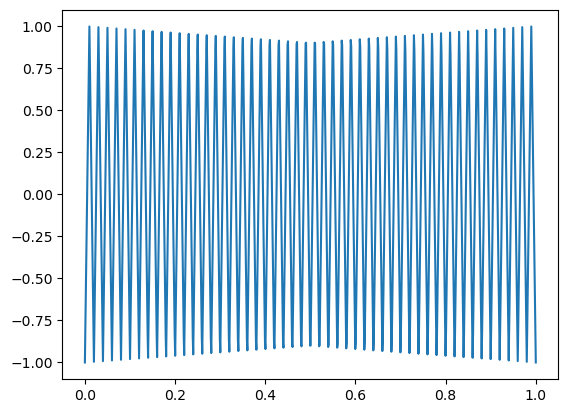

In [3]:

# Define tri-wave

def tri(period: float, amplitude: float):
    """
    triangle wave function centered around 0 with period and amplitude
    """

    def triangle_wave_transform(x: torch.Tensor):
        # using sigal
        return (amplitude / period) * (
            (period - abs(x % (2 * period) - (1 * period)) - period / 2)
        )

    return triangle_wave_transform


# Plot sample trianlge wave
x = torch.linspace(0, 1, 1000)
y = tri(0.01, 2)(x)
plt.plot(x, y)


We should be mindful of the imprecision increase in the triangle wave at larger values. As long as we don't make our period too small, and keep our distances passed in relatively small, we should be okay here. 

In [4]:

# Model Definitions

class PCN(nn.Module):
    def __init__(
        self,
        layers: list[int],
        dimensions: int = 20,
    ):
        super().__init__()
        self.weight_transform = tri(0.1, 1)
        if len(layers) < 2:
            raise ValueError("At least 2 layers are required")

        self.layers = nn.ParameterList(
            [nn.Parameter(torch.rand(l, dimensions) * 2 - 1) for l in layers]
        )
        self.layers_bias = nn.ParameterList(
            [nn.Parameter((torch.rand(l, 1) * 2 - 1) * 0.1) for l in layers]
        )

    def forward(self, x: torch.Tensor):
        z = x
        for i, (l, lnext) in enumerate(zip(self.layers, self.layers[1:])):
            z = (
                z @ (self.weight_transform(torch.cdist(l, lnext)) / np.sqrt(l.shape[0]))
            ) + self.layers_bias[i + 1].T
            if i < len(self.layers) - 2:
                z = torch.relu(z)
        return z


# control model
class FCN(nn.Module):
    def __init__(
        self,
        n_in: int,
        n_out: int,
        hidden: list[int],
    ):
        super().__init__()

        c = n_in
        L = []
        for l in hidden:
            L.append(nn.Linear(c, l))
            L.append(nn.ReLU())
            c = l

        L.append(nn.Linear(l, n_out))
        self.net = nn.Sequential(*L)

    def forward(self, x):
        return self.net(x)


## Stabilize the output of a layer

### Layer Size

In [5]:

# {layer size} -> {output variance} analysis

in_size = 1000
out_size = 100

num_tests = 100
agg_var = []
agg_mean = []
for i in range(num_tests):
    pcn = PCN([in_size, in_size, in_size, in_size, out_size])
    agg_var.append(pcn(torch.rand(1, in_size)).var())
    agg_mean.append(pcn(torch.rand(1, in_size)).mean())

torch.stack(agg_mean).mean(), torch.stack(agg_var).mean()


(tensor(0.0006, grad_fn=<MeanBackward0>),
 tensor(0.0035, grad_fn=<MeanBackward0>))

The trick here that seems to work is dividing by the `sqrt` of the previous layer's size when creating the weights going into the next layer. Doing this, we get a consistent variance on our layer output, regardless of the size of the previous or next layer.

The next question on this front would be: how does depth effect things (at first glance, it seems like the variance approaches zero as we deepen the network)? And does this matter? For now let's move on.

- Changing the period from 0.1 --> 0.01 doesn't seem to have an effect. For now let's default period to 0.1 (we want to make sure that our distances cover a full period at least, and 0.1 seems satisfactory for that).
- Amplitude expectedly effects the variance of the output linearly— for now let's default to 1.0.

### Tri-wave Amplitude

From quick experimentation, the amplitude seems to just directly effect the learning rate. This makes sense since it effects the gradient of the triangle wave which finds it's way to the learning rate. As we increase the amplitude, we have to decrease the learning rate.

An important note here is that, unlike traditional deep networks, there are min/max values that our network can possibly produce, tethered by the amplitude of the triangle wave. For classification, an amplitude of 1, with a learn rate of 0.01 suffices.

- When we increase the amplitude, and decrease the learning rate, this seems to degrade the optimum reached by the network. Decreasing the amplitude below 1 requires us to increase the learning rate, When we do this, (at least with a constant learning rate), the network will begin to learn, but then after it reaches a certain point, will flatline due to the learning rate being too high. My guess is that, we need the high learning rate at first to kick things off, but since we are training the network to predict classes as a binary 0 or 1, it will first "balloon out" so that it can reach that value of 1— at which point there is a higher variance in the output and a lower learn rate is appropriate. I wonder what the optimal amplitude would be if the network was trained to predict a binary (0, 0.5) or (0, 2).
- Because of the observed degration of optimality from increasing the amplitude beyond a necessary point, it seems important to look further into amplitude, and it's relationship with the gradient of our parameters.

### Neuron Position Dimensionality

In [6]:

# {position dimensionality} -> {output variance} analysis
# TODO : still working on normalizing this

in_size = 400
out_size = 10

num_tests = 100
agg_var = []
agg_mean = []
for i in range(num_tests):
    pcn = PCN([in_size, in_size, in_size, in_size, in_size, in_size, in_size, out_size], dimensions=1)
    agg_var.append(pcn(torch.rand(1, in_size)).var())
    agg_mean.append(pcn(torch.rand(1, in_size)).mean())

torch.stack(agg_mean).mean(), torch.stack(agg_var).mean()


(tensor(-0.0559, grad_fn=<MeanBackward0>),
 tensor(142.8091, grad_fn=<MeanBackward0>))

- At first glance, dimensionality seems to matter past a certain threshold of layer size. (specifically, working with a dimensionality of 1 instead of 20).
- I don't think the solution here is to vary the amplitude of our triangle wave based on dimensionality. These seem like they should be unrelated. My initial guess is that dimensionality effects the variance of the distance (lower dimensionality, lower distance), and if the variance of the distance is too low, it won't cover the full period of the triangle wave.

### PCN vs FCN

Since one of our main goals is to achieve as close to the same expressiveness as a regular FCN as possible, we should closely monitor their differences on several different metrics. Our default goal here for now is to ensure that our PCN outputs & behavior are as similar to the FCN as possible.

In [7]:

# Compare PCN & FCN outputs (mean, variance, etc.)

pcn = PCN([28 * 28, 1000, 1000, 1000, 1000, 10], dimensions=20)
fcn = FCN(28 * 28, 10, [100, 100, 100, 100, 100, 100, 100, 100])

pcn_out, fcn_out = pcn(torch.rand(1, 28 * 28)), fcn(torch.rand(1, 28 * 28))
print(pcn_out)
print(fcn_out)

pcn_out.mean(), pcn_out.var()
# fcn(torch.rand(1, 28 * 28)).mean()


tensor([[ 0.0011, -0.0715, -0.0224,  0.1120,  0.0817, -0.0863, -0.0895,  0.0483,
          0.0616, -0.1017]], grad_fn=<AddBackward0>)
tensor([[-0.0107,  0.0642, -0.0878,  0.0253,  0.0056,  0.0376,  0.1116, -0.0506,
         -0.0796,  0.0576]], grad_fn=<AddmmBackward0>)


(tensor(-0.0067, grad_fn=<MeanBackward0>),
 tensor(0.0063, grad_fn=<VarBackward0>))

In [8]:

# Clear log_dir

shutil.rmtree("log_dir", ignore_errors=True)

In [9]:

# Load Training Data

train = load_data(MNIST("train"))
test = load_data(MNIST("test"))

In [ ]:
import torch.utils.tensorboard as tb

log_dir = "log_dir"
learn_rate = 0.01
epochs = 100

cpu = torch.device("cpu")
gpu = torch.device("cuda:0")
device = gpu if torch.cuda.is_available() else cpu

models: list[tuple[str, nn.Module]] = [
    ("pcn", PCN([28 * 28, 400, 800, 1600, 3200, 10], dimensions=20).to(device)),
    ("fcn", FCN(28 * 28, 10, [400, 800, 1600, 3200]).to(device)),
]


loggers = [tb.SummaryWriter(log_dir + "/" + name) for name, _ in models]
optimizers = [
    torch.optim.SGD(models[0][1].parameters(), lr=0.01),
    torch.optim.SGD(models[1][1].parameters(), lr=0.01),
]
loss = nn.CrossEntropyLoss()

step = 0
for epoch in range(epochs):
    for i, (x, y) in enumerate(train):
        x = x.float().to(device)
        y = y.to(device)
        for (_, model), optimzer, logger in zip(models, optimizers, loggers):
            pred = model(x).float()
            l = loss(pred, y)

            l.backward()
            optimzer.step()
            optimzer.zero_grad()

            logger.add_scalar("loss", l, step)

        step += 1

    with torch.no_grad():
        for (_, model), logger in zip(models, loggers):
            correct = 0
            total = 0
            for i, (x, y) in enumerate(test):
                x = x.float().to(device)
                y = y.to(device)
                pred = model(x).float()

                correct += (pred.argmax(dim=1) == y).sum().item()
                total += y.shape[0]

            logger.add_scalar("accuracy", correct / total, epoch)

# Stabilize Gradients

Let's more specifically define our forces variable previously defined in `exp1`, where $F_{i}$ is the vector of forces acting on the $i^{th}$ neuron

$$|F_{i}| = |F_{i-1}| + |F{i+1}| + 1$$


We can say $\sigma(F) = \sum{\sigma(F_i)}$.

We are assuming that $F$ is composed of i.r.v.'s.

###### ***NOTE:*** ^ So the above, I thought I was going to try and math out the variance stuff to stabilize gradients but ended up just experimenting to get to a good spot. I think I said this below anyway, but even though I'm putting this off, I do think going through the math here will be very valuable and allow for more efficiency out of our pcn parameters.

In [12]:
class pcnSGD(torch.optim.Optimizer):
    def __init__(self, model: nn.Module, lr=1e-3, opp=None):
        self.opp = opp
        self.model = model
        defaults = dict(lr=lr)
        super(pcnSGD, self).__init__(model.parameters(), defaults)

    def step(self, closure=None):
        loss = None
        if closure is not None:
            loss = closure()

        # for param in 

        for group in self.param_groups:
            positions = group["params"][:int(len(group["params"])/2)]
            biases = group["params"][int(len(group["params"])/2):]

            for pos in positions:
                if pos.grad is None:
                    continue
                grad = pos.grad.data
                # apply custom gradient descent update
                
                if self.opp == None:
                    pos.data.add_(-group["lr"] * (pos.shape[0]), grad)
                elif self.opp == "log":
                    pos.data.add_(-group["lr"] * (pos.shape[0] / np.log2(pos.shape[0])), grad)
                elif self.opp == "sqrt":
                    pos.data.add_(-group["lr"] * (np.sqrt(pos.shape[0])), grad)


            for bias in biases:
                if bias.grad is None:
                    continue
                grad = bias.grad.data
                # apply custom gradient descent update
                bias.data.add_(-group["lr"], grad)

        return loss

In [13]:

# Clear log_dir

shutil.rmtree("log_dir", ignore_errors=True)

In [14]:
def pcn_analyize(model: PCN):
    print(f"model {[l.shape[0] for l in model.layers]}")
    print(f"position variances: {[l.grad.var().item() * (l.shape[0] / np.log2(l.shape[0])) for l in model.layers]}")
    print(f"bias variances: {[l.grad.var().item() if l.grad is not None else None for l in model.layers_bias]}")

def fcn_analyize(model: FCN):
    pass

In [ ]:
import torch.utils.tensorboard as tb

log_dir = "log_dir"
learn_rate = 0.01
epochs = 100

cpu = torch.device("cpu")
gpu = torch.device("cuda:0")
device = gpu if torch.cuda.is_available() else cpu

models: list[tuple[str, nn.Module]] = [
    # ("pcn128", PCN([28 * 28, 128, 128, 128, 10], dimensions=20).to(device)),
    # ("pcn256", PCN([28 * 28, 256, 256, 256, 10], dimensions=20).to(device)),
    # ("pcn512", PCN([28 * 28, 512, 512, 512, 10], dimensions=20).to(device)),
    # ("pcn1024", PCN([28 * 28, 1024, 1024, 1024, 10], dimensions=20).to(device)),
    # ("pcn2048", PCN([28 * 28, 2048, 2048, 2048, 10], dimensions=20).to(device)),
    ("pcn2048_custom_reg", PCN([28 * 28, 2048, 2048, 2048, 10], dimensions=20).to(device)),
    ("pcn2048_custom_log", PCN([28 * 28, 2048, 2048, 2048, 10], dimensions=20).to(device)),
    ("pcn2048_custom_sqrt", PCN([28 * 28, 2048, 2048, 2048, 10], dimensions=20).to(device)),
    ("pcn2048", PCN([28 * 28, 2048, 2048, 2048, 10], dimensions=20).to(device)),
    ("fcn", FCN(28 * 28, 10, [400, 800, 1600, 3200]).to(device)),
]

analyizers = [
    # pcn_analyize,
    # pcn_analyize,
    pcn_analyize,
    pcn_analyize,
    pcn_analyize,
    pcn_analyize,
    fcn_analyize,
]

loggers = [tb.SummaryWriter(log_dir + "/" + name) for name, _ in models]
optimizers = [
    # pcnSGD(models[0][1], lr=0.002),
    # pcnSGD(models[1][1], lr=0.002),
    # pcnSGD(models[2][1], lr=0.002),
    # pcnSGD(models[3][1], lr=0.002),
    # pcnSGD(models[4][1], lr=0.002),

    # torch.optim.SGD(models[1][1].parameters(), lr=0.02),
    pcnSGD(models[0][1], lr=0.000015, opp=None),
    pcnSGD(models[1][1], lr=0.0005, opp="log"),
    pcnSGD(models[2][1], lr=0.002, opp="sqrt"),
    torch.optim.SGD(models[3][1].parameters(), lr=0.01),
    torch.optim.SGD(models[4][1].parameters(), lr=0.01),
]

loss = nn.CrossEntropyLoss()

step = 0
for epoch in range(epochs):
    for i, (x, y) in enumerate(train):
        x = x.float().to(device)
        y = y.to(device)
        # print(f"RUN {step} -----------------------------")
        for (_, model), analize, optimzer, logger in zip(models, analyizers, optimizers, loggers):
            pred = model(x).float()
            l = loss(pred, y)

            l.backward()
            # analize(model)

            optimzer.step()
            optimzer.zero_grad()

            logger.add_scalar("loss", l, step)

        step += 1

    with torch.no_grad():
        for (_, model), logger in zip(models, loggers):
            correct = 0
            total = 0
            for i, (x, y) in enumerate(test):
                x = x.float().to(device)
                y = y.to(device)
                pred = model(x).float()

                correct += (pred.argmax(dim=1) == y).sum().item()
                total += y.shape[0]

            logger.add_scalar("accuracy", correct / total, epoch)

I am going to pause this experimenting with the above training loop in order to perserve it for later use, documentation, etc.

But for now, we've concluded that there is clearly some regularization to be done with learning rate with respect to the layer size. Layers with more neurons seem to have a smaller gradient per parameter, effectively making it so that layers with the least neurons learn the fastest. This makes it difficult to use a constant learning rate for networks with layers that vary in size.

By scaling the learning rate by some order of magnitude of the layer size, we see significant results in terms of convergence speed, as well as the final accuracy achieved by the network.

But for each scaling method we've tried, there seems to be something else missing, as the accuracy and loss seems relatively unstable, especially after the first few initial iterations (unsure, but I think this may be related to that "ballooning" effect I mentioned earlier). The scaling methods we've tried (nonexaustive) are, where $n$ is the layer size:
 - $n$
 - $\sqrt{n}$
 - $\frac{n}{\log{n}}$

It's difficult to judge via experimentation which of these options is best, especially considering that each has a different optimal learning rate, which is up to me to find. Assuming that the tuning I've done is adequate for each of the 3 options, $\sqrt{n}$ and $\frac{n}{\log{n}}$ seem to be nearly identical in terms of how they perform, the shape of their loss/accuracy, etc. $n$ seems to be consistently the worst option, but again, this could be due to it's learning rate being not as well tuned as the other two, or some other factors. The effect of these 3 options may be more obvious via experimentation at higher scales, but that won't really be possible until I figure out how to make auto-grad not hold onto the calculated weight matrices.


The choice of the correct scaling factor here really should be solved directly via maths rather than guess-work & experimentation. There's clearly something more complex missing when we see the irregularity in loss/accuracy, which will unlikely be found by guess-work. But for now... :-)

Let's move forward using the $\sqrt{n}$ option, and see if we can get a network that learns stability, invariant of the dimensionality of the neuron positions.

*(side note: bias learn rate should be fixed as well. It's learning is many orders of magnitude smaller than the neuron positions atm. Also, there seems to be a relation with the depth of the network [as we traverse back through the network, bias gradient gets smaller & smaller])*

- just some more observations. The "irregularity" in the accuracy seems to be some kind of "hopping" where the acuraccy arcs up, and then back down, but lands somewhere slightly higher, and repeats this pattern over and over

# Stabilize Gradients (again, but this time with respect to dimensionality)


In [16]:
class pcnSGD(torch.optim.Optimizer):
    def __init__(self, model: nn.Module, lr=1e-3, opp=None):
        self.opp = opp
        self.model = model
        defaults = dict(lr=lr)
        super(pcnSGD, self).__init__(model.parameters(), defaults)

    def step(self, closure=None):
        loss = None
        if closure is not None:
            loss = closure()

        # for param in 

        for group in self.param_groups:
            positions = group["params"][:int(len(group["params"])/2)]
            biases = group["params"][int(len(group["params"])/2):]

            for pos in positions:
                if pos.grad is None:
                    continue
                grad = pos.grad.data
                # apply custom gradient descent update
                
                if self.opp == None:
                    pos.data.add_(-group["lr"] * (pos.shape[0]), grad)
                elif self.opp == "log":
                    pos.data.add_(-group["lr"] * (pos.shape[0] / np.log2(pos.shape[0])), grad)
                elif self.opp == "sqrt":
                    pos.data.add_(-group["lr"] * (np.sqrt(pos.shape[0])), grad)


            for bias in biases:
                if bias.grad is None:
                    continue
                grad = bias.grad.data
                # apply custom gradient descent update
                bias.data.add_(-group["lr"] * 1e5, grad)

        return loss

In [38]:
shutil.rmtree("log_dir", ignore_errors=True)

In [39]:

import torch.utils.tensorboard as tb

log_dir = "log_dir"
learn_rate = 0.01
epochs = 100

cpu = torch.device("cpu")
gpu = torch.device("cuda:0")
device = gpu if torch.cuda.is_available() else cpu

models: list[tuple[str, nn.Module]] = [
    # ("pcn2048_1D", PCN([28 * 28, 3200, 3200, 3200, 3200, 10], dimensions=1).to(device)),
    ("pcn2048_2D", PCN([28 * 28, 4096, 10], dimensions=4).to(device)),
    # ("pcn2048_4D", PCN([28 * 28, 400, 400, 400, 400, 10], dimensions=4).to(device)),
    ("pcn2048_16D", PCN([28 * 28, 256, 10], dimensions=16).to(device)),
    ("fcn", FCN(28 * 28, 10, [100, 100, 100, 100]).to(device)),
]

analyizers = [
    # pcn_analyize,
    pcn_analyize,
    pcn_analyize,
    fcn_analyize,
]

loggers = [tb.SummaryWriter(log_dir + "/" + name) for name, _ in models]
optimizers = [
    # pcnSGD(models[0][1], lr=0.00000001, opp="log"),
    pcnSGD(models[0][1], lr=0.00002, opp="log"),
    pcnSGD(models[1][1], lr=0.0002, opp="log"),
    torch.optim.SGD(models[2][1].parameters(), lr=0.01),
]

loss = nn.CrossEntropyLoss()

step = 0
for epoch in range(epochs):
    for i, (x, y) in enumerate(train):
        x = x.float().to(device)
        y = y.to(device)
        print(f"RUN {step} -----------------------------")
        for (_, model), analize, optimzer, logger in zip(models, analyizers, optimizers, loggers):
            pred = model(x).float()
            l = loss(pred, y)

            l.backward()
            analize(model)

            optimzer.step()
            optimzer.zero_grad()

            logger.add_scalar("loss", l, step)

        step += 1

    with torch.no_grad():
        for (_, model), logger in zip(models, loggers):
            correct = 0
            total = 0
            for i, (x, y) in enumerate(test):
                x = x.float().to(device)
                y = y.to(device)
                pred = model(x).float()

                correct += (pred.argmax(dim=1) == y).sum().item()
                total += y.shape[0]

            logger.add_scalar("accuracy", correct / total, epoch)

RUN 0 -----------------------------
model [784, 4096, 10]
position variances: [83.70270320805602, 62.95647684733073, 274.30699208695324]
bias variances: [None, 6.80152311360871e-07, 0.009284372441470623]
model [784, 256, 10]
position variances: [12.974979069733205, 50.34886932373047, 65.27209450831845]
bias variances: [None, 1.816618168959394e-05, 0.016119299456477165]
RUN 1 -----------------------------
model [784, 4096, 10]
position variances: [134.20921056086084, 264.1055704752604, 469.0527429721848]
bias variances: [None, 2.8750725959980628e-06, 0.04815788194537163]
model [784, 256, 10]
position variances: [21.167420542317885, 89.35885620117188, 65.90272745326013]
bias variances: [None, 3.558255411917344e-05, 0.035426944494247437]
RUN 2 -----------------------------
model [784, 4096, 10]
position variances: [81.92398216222696, 175.27490234375, 723.479311951482]
bias variances: [None, 2.275507313242997e-06, 0.03925957903265953]
model [784, 256, 10]
position variances: [29.3860952973